### Thinking1
什么是Graph Embedding，都有哪些算法模型

答：Graph Embedding指从图网络中进行特征提取，将每个节点用相对低维的固定维度向量进行表示，并且要求这种表示能够反映原网络中节点的一些特性，例如两个节点相连、两个节点连接的节点相似（近邻相似），或两个节点的所处的空间结构相似，则两个节点的向量表示也应该相似。具体的算法模型有：  
基于近邻相似：DeepWalk（RandomWalk采样+Word2Vec）, Node2Vec（在DeepWalk基础上增加参数q,p使游走策略可调整，可偏向深度优先或广度优先），LINE（分别优化1阶相似度和2阶相似度），SDNE（同时优化1、2阶相似度）  
基于空间结构相似：Struc2Vec

### Thinking2
如何使用Graph Embedding在推荐系统，比如NetFlix 电影推荐，请说明简要的思路

答：对用户的观看行为按照时间切分成一个一个的session，然后以各用户观看过的电影为节点，用户在每个session内部的观看顺序为方向，连接成有向图，每条边的权重随这条边出现次数的增加而增加，最终得到一张有向有权图，利用这张图进行Graph Embedding得到各电影的特征向量，可向用户推荐与他最近观看的电影向量表达相似的那些电影。

### Thinking3
数据探索EDA都有哪些常用的方法和工具

答：常用方法和对应工具如下：  
（1）查看数据的整体信息：   
查看数据信息（列名、非空个数、类型等）：df.info()  
查看数据统计信息（均值、方差、最大最小值等）：df.describe()  
查看离散数据信息（众数，众数对应频次等）:df.describe(include=['O'])  

（2）查看数据缺失情况：  
查看列是否缺失：df.isnull().any()  
查看列缺失条数：df.isnull().sum()  
缺失情况可视化：msno.matrix(df), msno.bar(df), msno.heatmap(df)

（3）查看数据分布情况：  
与相应的无界约翰逊分布、正太分布以及对数正态分布等经典分布情况进行比对：
sns.distplot(y, kde=False, fit=st.johnsonsu/st.norm/st.lognorm)

### Action1
seealsology是个针对Wikipidea页面的语义分析工具，可以找到与指定页面相关的Wikipidea
seealsology-data.tsv 文件存储了Wikipidea页面的关系（Source, Target, Depth）
使用Graph Embedding对节点（Wikipidea）进行Embedding（DeepWalk或Node2Vec模型）
对Embedding进行可视化（使用PCA呈现在二维平面上）
找到和critical illness insurance相关的页面

In [12]:
import warnings
warnings.filterwarnings('ignore')

# 数据加载
import pandas as pd

df = pd.read_csv('./seealsology-data.tsv', sep='\t')
df.head()

,source,target,depth
0,life insurance,corporate-owned life insurance,1
1,life insurance,critical illness insurance,1
2,life insurance,economic capital,1
3,life insurance,estate planning,1
4,life insurance,false insurance claims,1


In [13]:
# 构造图
import networkx as nx

G = nx.from_pandas_dataframe(df, 'source', 'target', edge_attr=True, create_using=nx.Graph())

In [15]:
# 创建DeepWalk模型
from ge import DeepWalk, Node2Vec
# model = DeepWalk(G, walk_length=10, num_walks=5)
model = Node2Vec(G, walk_length=10, num_walks=5, p=2, q=0.25) #DFS

# 模型训练
model.train(window_size=3, iter=30)
embeddings = model.get_embeddings()

Preprocess transition probs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s finished


Learning embedding vectors...
Learning embedding vectors done!


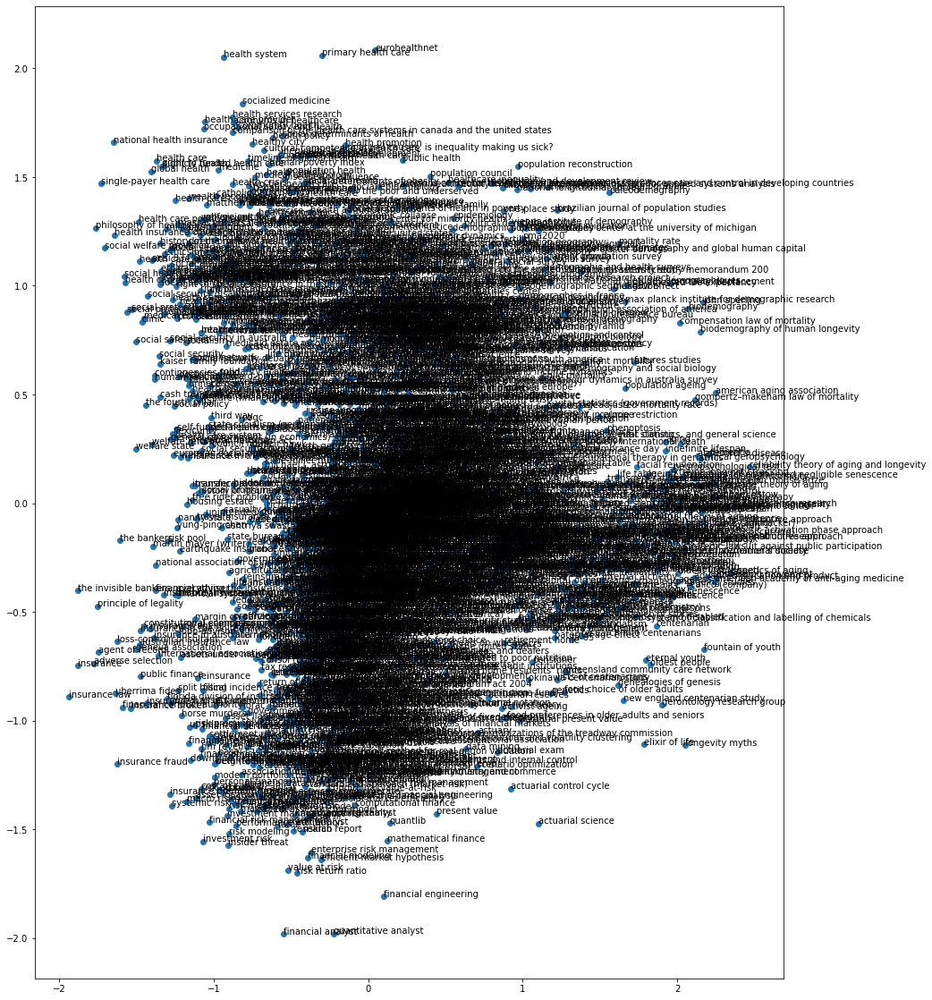

In [52]:
# 在二维空间中绘制所选节点的向量
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def plot_nodes(word_list):
    # 返回word_embedding结果
    word_embeddings = []
    for item in word_list:
        word_embeddings.append(embeddings[item])
    
    # 降为2维
    pca = PCA(n_components=2)
    result = pca.fit_transform(word_embeddings)
    
    # 绘图
    plt.figure(figsize=(15,20))
    plt.scatter(result[:, 0], result[:, 1])
    for i, word in enumerate(list(word_list)):
        plt.annotate(word, xy=(result[i, 0], result[i, 1]))        
    plt.show()

plot_nodes(model.w2v_model.wv.vocab)

In [55]:
# ‘critical illness insurance’的top10相关页面
from sklearn.metrics.pairwise import cosine_similarity

cosines = {}
for word in model.w2v_model.wv.vocab:
    cosines[word] = cosine_similarity([embeddings[word], embeddings['critical illness insurance']])[0,1]
rank = list(cosines.items())
rank.sort(key=lambda x: x[1], reverse=True)
top10 = [rank[i][0] for i in range(1,11)]
top10

['total permanent disability insurance',
 "servicemembers' group life insurance",
 'tontine',
 'prescription analytics',
 'anicom',
 'whole life insurance',
 'corporate-owned life insurance',
 'internal revenue code section 79',
 'term life insurance',
 'medicaid estate recovery']

### Action2
二手车价格预测
数据集：
used_car_train_20200313.csv
used_car_testA_20200313.csv
数据来自某交易平台的二手车交易记录
ToDo：给你一辆车的各个属性（除了price字段），预测它的价格

In [56]:
import warnings
warnings.filterwarnings('ignore')

# 载入数据
import pandas as pd
train_data = pd.read_csv('./used_car_train_20200313.csv', sep=' ')
test_data = pd.read_csv('./used_car_testB_20200421.csv', sep=' ')
print('train_data shape:', train_data.shape)
print('test_data shape:', test_data.shape)
train_data.head()

train_data shape: (150000, 31)
test_data shape: (50000, 30)


,SaleID,name,regDate,model,brand,bodyType,fuelType,gearbox,power,kilometer,...,v_5,v_6,v_7,v_8,v_9,v_10,v_11,v_12,v_13,v_14
0,0,736,20040402,30.0,6,1.0,0.0,0.0,60,12.5,...,0.235676,0.101988,0.129549,0.022816,0.097462,-2.881803,2.804097,-2.420821,0.795292,0.914762
1,1,2262,20030301,40.0,1,2.0,0.0,0.0,0,15.0,...,0.264777,0.121004,0.135731,0.026597,0.020582,-4.900482,2.096338,-1.030483,-1.722674,0.245522
2,2,14874,20040403,115.0,15,1.0,0.0,0.0,163,12.5,...,0.251410,0.114912,0.165147,0.062173,0.027075,-4.846749,1.803559,1.565330,-0.832687,-0.229963
3,3,71865,19960908,109.0,10,0.0,0.0,1.0,193,15.0,...,0.274293,0.110300,0.121964,0.033395,0.000000,-4.509599,1.285940,-0.501868,-2.438353,-0.478699
4,4,111080,20120103,110.0,5,1.0,0.0,0.0,68,5.0,...,0.228036,0.073205,0.091880,0.078819,0.121534,-1.896240,0.910783,0.931110,2.834518,1.923482


In [57]:
# 数据探索
pd.set_option('display.max_columns', None) #显示所有列

# 查看train_data信息
print('查看数据信息：列名、非空个数、类型等')
print(train_data.info())
print('-'*30)
print('查看数据统计信息')
print(train_data.describe())
print('-'*30)
print('查看离散数据信息')
print(train_data.describe(include=['O']))
print('-'*30)

查看数据信息：列名、非空个数、类型等
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 31 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   SaleID             150000 non-null  int64  
 1   name               150000 non-null  int64  
 2   regDate            150000 non-null  int64  
 3   model              149999 non-null  float64
 4   brand              150000 non-null  int64  
 5   bodyType           145494 non-null  float64
 6   fuelType           141320 non-null  float64
 7   gearbox            144019 non-null  float64
 8   power              150000 non-null  int64  
 9   kilometer          150000 non-null  float64
 10  notRepairedDamage  150000 non-null  object 
 11  regionCode         150000 non-null  int64  
 12  seller             150000 non-null  int64  
 13  offerType          150000 non-null  int64  
 14  creatDate          150000 non-null  int64  
 15  price              150000 non-nu

In [58]:
# 查看缺失值情况
print(train_data.isnull().any())
print('-'*30)
print(train_data.isnull().sum())

SaleID               False
name                 False
regDate              False
model                 True
brand                False
bodyType              True
fuelType              True
gearbox               True
power                False
kilometer            False
notRepairedDamage    False
regionCode           False
seller               False
offerType            False
creatDate            False
price                False
v_0                  False
v_1                  False
v_2                  False
v_3                  False
v_4                  False
v_5                  False
v_6                  False
v_7                  False
v_8                  False
v_9                  False
v_10                 False
v_11                 False
v_12                 False
v_13                 False
v_14                 False
dtype: bool
------------------------------
SaleID                  0
name                    0
regDate                 0
model                   1
brand           

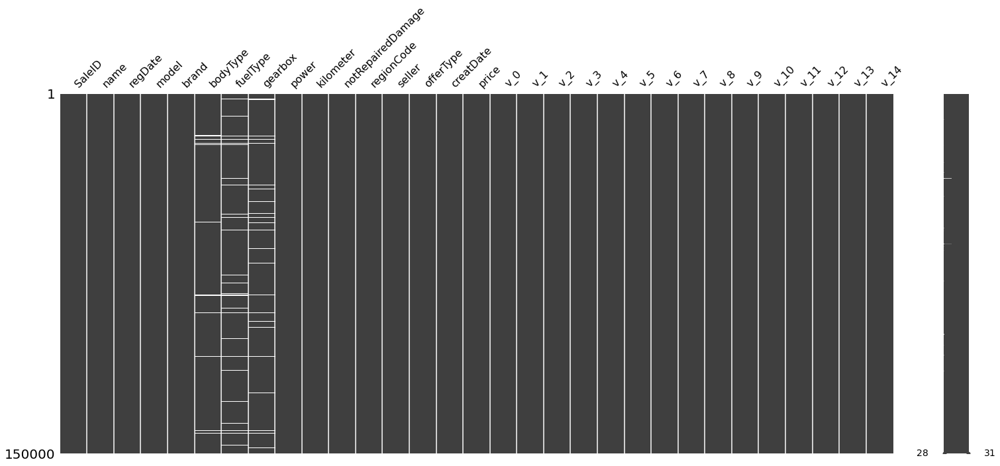

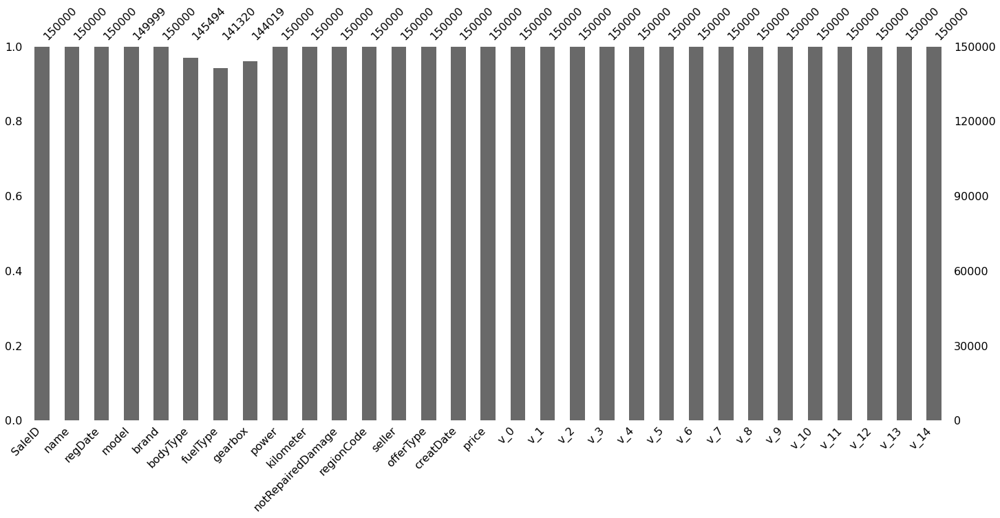

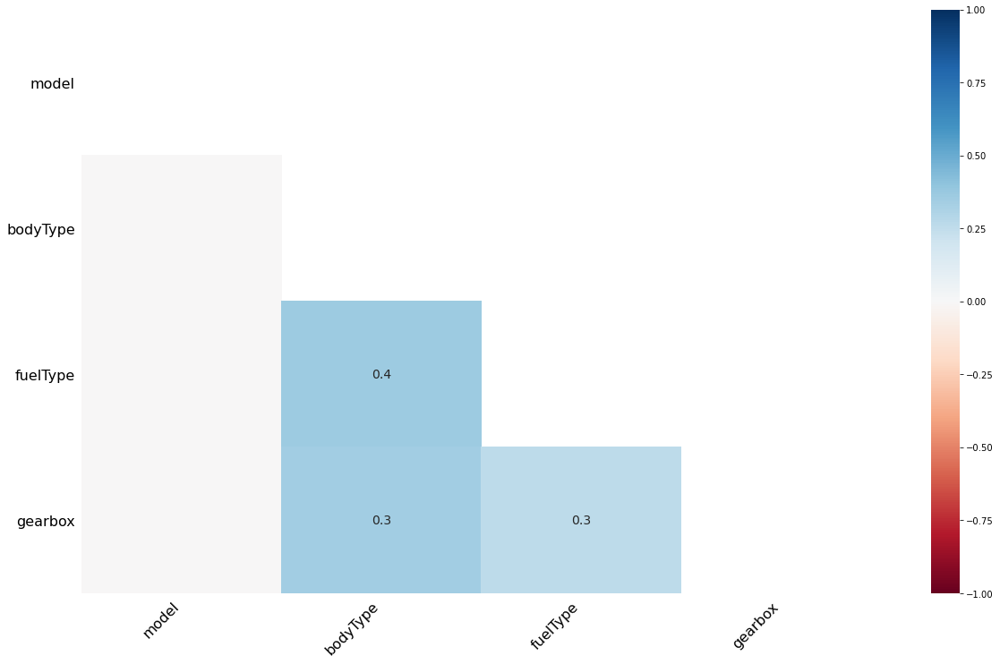

In [69]:
# 缺失情况可视化
import missingno as msno
import matplotlib.pyplot as plt

msno.matrix(train_data)
plt.show()

msno.bar(train_data)
plt.show()

msno.heatmap(train_data)
plt.show()

In [71]:
train_data.columns

Index(['SaleID', 'name', 'regDate', 'model', 'brand', 'bodyType', 'fuelType',
       'gearbox', 'power', 'kilometer', 'notRepairedDamage', 'regionCode',
       'seller', 'offerType', 'creatDate', 'price', 'v_0', 'v_1', 'v_2', 'v_3',
       'v_4', 'v_5', 'v_6', 'v_7', 'v_8', 'v_9', 'v_10', 'v_11', 'v_12',
       'v_13', 'v_14'],
      dtype='object')

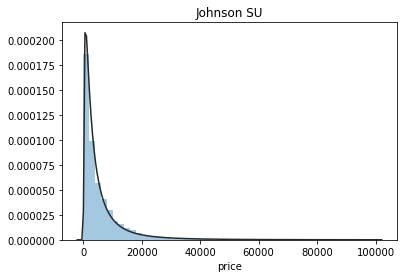

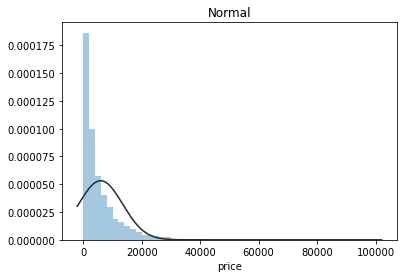

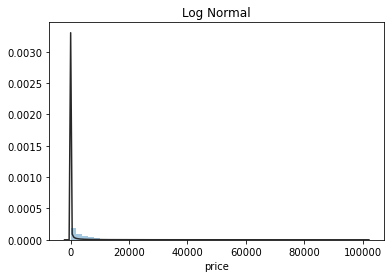

In [76]:
# 查看价格数据分布情况
import scipy.stats as st
import seaborn as sns

y = train_data['price']
plt.figure(1)
plt.title('Johnson SU')
sns.distplot(y, kde=False, fit=st.johnsonsu)
plt.figure(2)
plt.title('Normal')
sns.distplot(y, kde=False, fit=st.norm)
plt.figure(3)
plt.title('Log Normal')
sns.distplot(y, kde=False, fit=st.lognorm)
plt.show()

可见数据分布与正态分布不太相合。

In [79]:
# pandas_profiling工具
import pandas_profiling as pp
report = pp.ProfileReport(train_data)
report

In [81]:
report.to_file('report.html')